<a href="https://colab.research.google.com/github/rahadiyant/dataku/blob/main/Scarp_Playstoe_bmkg.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
pip install google-search-results

  Preparing metadata (setup.py) ... done
  Created wheel for google-search-results: filename=google_search_results-2.4.2-py3-none-any.whl size=32009 sha256=142ecefcfaeb8e28aae11c258dd1afacf9057a71d8a451cdef09d3f8bae128b8
  Stored in directory: /root/.cache/pip/wheels/d3/b2/c3/03302d12bb44a2cdff3c9371f31b72c0c4e84b8d2285eeac53
Successfully built google-search-results


In [2]:
from serpapi import GoogleSearch
from urllib.parse import (parse_qsl, urlsplit)
import json

params = {
    'api_key': '...',                        # https://serpapi.com/manage-api-key
    "engine": "google_play_product",         # parsing engine
    "store": "apps",                         # app page
    "gl": "us",                              # country of the search
    "product_id": "com.MapstarAG.Mapstar3D", # low review count example to show it exits the while loop
    "all_reviews": "true"                    # shows all reviews
}

search = GoogleSearch(params)                # where data extraction happens


def serpapi_scrape_google_play_app_data():
    results = search.get_dict()

    print(json.dumps(results["product_info"], indent=2, ensure_ascii=False))
    print(json.dumps(results["media"], indent=2, ensure_ascii=False))
    # other data


def serpapi_scrape_google_play_app_reviews():
    # to show the page number
    page_num = 0

    # iterate over all pages
    while True:
        results = search.get_dict()              # JSON -> Python dict

        if "error" in results:
            print(results["error"])
            break

        page_num += 1
        print(f"Current page: {page_num}")

        # iterate over organic results and extract the data
        for result in results.get("reviews", []):
            print(result.get("title"), result.get("date"), sep="\n")

        # check if the next page key is present in the JSON
        # if present -> split URL in parts and update to the next page
        if "next" in results.get("serpapi_pagination", {}):
            search.params_dict.update(dict(parse_qsl(urlsplit(results.get("serpapi_pagination").get("next")).query)))
        else:
            break

In [5]:
pip install google-play-scraper

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 2.0 MB/s eta 0:00:00


In [6]:
from google_play_scraper import Sort, reviews_all
import pandas as pd

In [15]:
scrapreview= reviews_all(
'com.Info_BMKG', #ID aplikasi
lang='id', # defaults to ‘en’
country='id', # defaults to ‘us’
sort=Sort.MOST_RELEVANT, # defaults to Sort.MOST_RELEVANT
filter_score_with=None # defaults to None (means all score)
)


In [16]:
# Mengambil semua ulasan aplikasi
reviews = reviews_all(
    app_id,
    lang='id',  # Bahasa ulasan
    country='id'  # Negara
)

# Konversi ke DataFrame
df_reviews = pd.DataFrame(reviews)

# Menampilkan beberapa ulasan
print("\nBeberapa Ulasan:")
print(df_reviews[['userName', 'score', 'at', 'content']].head())



Beberapa Ulasan:
          userName  score                  at  \
0  Pengguna Google      5 2024-11-24 06:13:09   
1  Pengguna Google      2 2024-11-24 05:40:53   
2  Pengguna Google      1 2024-11-24 00:30:42   
3  Pengguna Google      5 2024-11-23 06:35:01   
4  Pengguna Google      5 2024-11-23 00:27:30   

                                             content  
0  Mohon maaf BMKG sebelumnya, bahwa di radar unt...  
1                                masih kurang akurat  
2           Sekarang melihat radar awan kok gak bisa  
3                                                 Ok  
4                                             mantap  


In [18]:
# Nama file output
output_file = "bmkg_reviews.csv"

# Simpan ke file CSV
df_reviews.to_csv(output_file, index=False)
print(f"\nData ulasan berhasil disimpan ke file: {output_file}")



Data ulasan berhasil disimpan ke file: bmkg_reviews.csv


In [20]:
app_reviews_df.head()

,reviewId,userName,userImage,content,score,thumbsUpCount,reviewCreatedVersion,at,replyContent,repliedAt,appVersion
0,2e944409-c382-44f3-9fa3-969fff1ffda3,Pengguna Google,https://play-lh.googleusercontent.com/EGemoI2N...,Aplikasinya cukup bagus. Cuma sedikit saran aj...,5,27,3.3.2,2024-11-10 07:50:44,None,NaT,3.3.2
1,68781947-21c9-4bad-ac54-a1bab7a84797,Pengguna Google,https://play-lh.googleusercontent.com/EGemoI2N...,"Aplikasi sangat membantu, tapi sayang.a daerah...",5,8,3.3.2,2024-11-17 13:35:55,None,NaT,3.3.2
2,7528e062-9548-462c-a0eb-3ec7ddecd921,Pengguna Google,https://play-lh.googleusercontent.com/EGemoI2N...,Cukup akurat.. Tapi tolong untuk cuaca di bagu...,5,64,3.3.1,2024-10-28 08:29:53,None,NaT,3.3.1
3,a76aceba-6e1f-43bd-8436-791a7070de95,Pengguna Google,https://play-lh.googleusercontent.com/EGemoI2N...,Untuk informasi kualitas udara mohon diperluas...,3,1,3.3.2,2024-11-12 10:26:44,None,NaT,3.3.2
4,e6b3ec11-e34e-4501-8d25-e4742750dff0,Pengguna Google,https://play-lh.googleusercontent.com/EGemoI2N...,"Saya mau kasih saran, untuk notifikasi gempa s...",5,2,3.3.2,2024-11-14 08:44:28,None,NaT,3.3.2


In [21]:
!pip install matplotlib wordcloud pandas


In [22]:
import pandas as pd
import matplotlib.pyplot as plt
from wordcloud import WordCloud


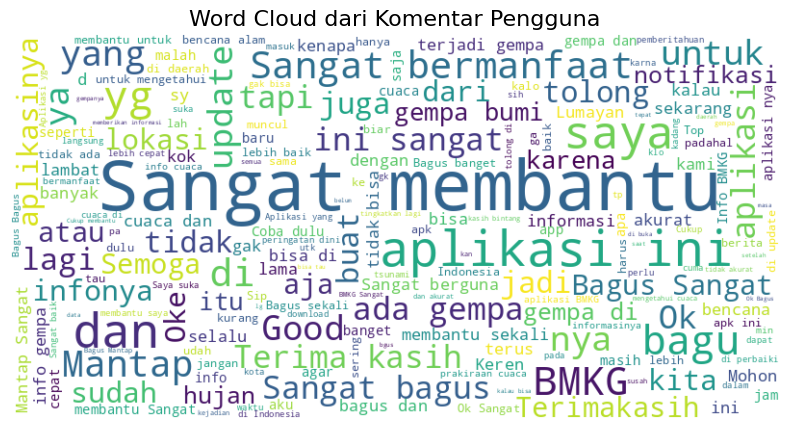

In [23]:
# Membaca file CSV yang berisi ulasan aplikasi
df_reviews = pd.read_csv("bmkg_reviews.csv")

# Menggabungkan semua komentar menjadi satu string
all_comments = " ".join(df_reviews['content'].dropna())

# Membuat word cloud
wordcloud = WordCloud(
    width=800,
    height=400,
    background_color='white',
    colormap='viridis',
    max_words=200
).generate(all_comments)

# Menampilkan word cloud
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')  # Menghilangkan sumbu
plt.title("Word Cloud dari Komentar Pengguna", fontsize=16)
plt.show()


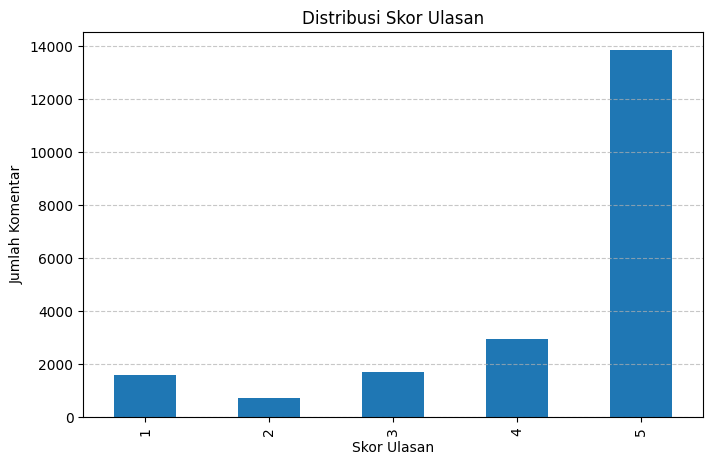

In [24]:
# Membuat histogram skor ulasan
plt.figure(figsize=(8, 5))
df_reviews['score'].value_counts().sort_index().plot(kind='bar')

# Menambahkan label dan judul
plt.xlabel("Skor Ulasan")
plt.ylabel("Jumlah Komentar")
plt.title("Distribusi Skor Ulasan")
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()


<ipython-input-25-327a88fa32e1>:5: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  reviews_per_month = df_reviews.set_index('at').resample('M').size()


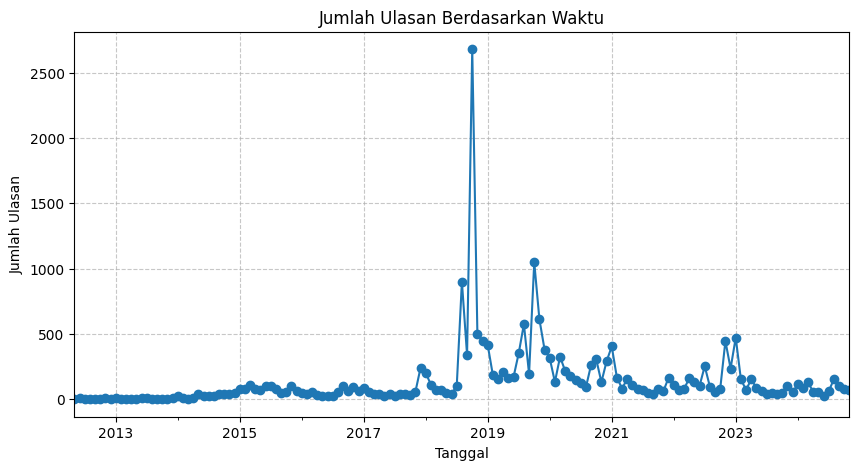

In [25]:
# Konversi kolom 'at' menjadi format datetime
df_reviews['at'] = pd.to_datetime(df_reviews['at'])

# Menghitung jumlah ulasan per bulan
reviews_per_month = df_reviews.set_index('at').resample('M').size()

# Membuat plot garis
plt.figure(figsize=(10, 5))
reviews_per_month.plot(kind='line', marker='o')

# Menambahkan label dan judul
plt.xlabel("Tanggal")
plt.ylabel("Jumlah Ulasan")
plt.title("Jumlah Ulasan Berdasarkan Waktu")
plt.grid(axis='both', linestyle='--', alpha=0.7)
plt.show()


In [26]:
import pandas as pd

# Menampilkan semua data ulasan
pd.set_option('display.max_rows', None)  # Menampilkan semua baris
pd.set_option('display.max_columns', None)  # Menampilkan semua kolom

# Pastikan Anda sudah memiliki DataFrame, misalnya df_reviews
print(df_reviews)


                                   reviewId         userName  \
0      6a761233-e611-46b2-8a95-0cf407c16278  Pengguna Google   
1      b5dfc95a-046f-4461-96ce-c0848f7d35f8  Pengguna Google   
2      ad65a40d-6cb0-44fe-9678-3778adf144d4  Pengguna Google   
3      5d3f5ab3-8cdf-417c-a47b-b692a822e50c  Pengguna Google   
4      c77d186a-6053-4a27-896b-f3134a590b52  Pengguna Google   
5      98068903-bcf6-499a-a5aa-d7373c4c2934  Pengguna Google   
6      4164c4c7-be6b-4fe0-9059-fd7e4f244854  Pengguna Google   
7      f02426ac-937c-45ca-9cd3-06ca0fe15f13  Pengguna Google   
8      8628c176-c1ec-49db-abe8-d04e2e7f352a  Pengguna Google   
9      4cbf24d0-a596-468f-96c0-916fa566da8f  Pengguna Google   
10     f34bd15f-21f7-4a6c-9a84-0101426ba4e2  Pengguna Google   
11     c49a2963-0233-46a5-a9cc-3e0c465666bf  Pengguna Google   
12     68afd77a-19ea-41a0-96b4-98001412203a  Pengguna Google   
13     7781cd52-8266-4c50-af8e-b657c0047369  Pengguna Google   
14     a4aa6403-2047-40cc-a1ef-3bfb3eefe

In [27]:
# Membaca file CSV
df_reviews = pd.read_csv("bmkg_reviews.csv")

# Menampilkan tabel interaktif
from google.colab import data_table
data_table.DataTable(df_reviews)


,reviewId,userName,userImage,content,score,thumbsUpCount,reviewCreatedVersion,at,replyContent,repliedAt,appVersion
0,6a761233-e611-46b2-8a95-0cf407c16278,Pengguna Google,https://play-lh.googleusercontent.com/EGemoI2N...,"Mohon maaf BMKG sebelumnya, bahwa di radar unt...",5,0,3.3.2,2024-11-24 06:13:09,NaN,NaN,3.3.2
1,b5dfc95a-046f-4461-96ce-c0848f7d35f8,Pengguna Google,https://play-lh.googleusercontent.com/EGemoI2N...,masih kurang akurat,2,0,3.3.2,2024-11-24 05:40:53,NaN,NaN,3.3.2
2,ad65a40d-6cb0-44fe-9678-3778adf144d4,Pengguna Google,https://play-lh.googleusercontent.com/EGemoI2N...,Sekarang melihat radar awan kok gak bisa,1,0,3.3.2,2024-11-24 00:30:42,NaN,NaN,3.3.2
3,5d3f5ab3-8cdf-417c-a47b-b692a822e50c,Pengguna Google,https://play-lh.googleusercontent.com/EGemoI2N...,Ok,5,0,NaN,2024-11-23 06:35:01,NaN,NaN,NaN
4,c77d186a-6053-4a27-896b-f3134a590b52,Pengguna Google,https://play-lh.googleusercontent.com/EGemoI2N...,mantap,5,0,NaN,2024-11-23 00:27:30,NaN,NaN,NaN
5,98068903-bcf6-499a-a5aa-d7373c4c2934,Pengguna Google,https://play-lh.googleusercontent.com/EGemoI2N...,Aplikasi ini sangat membantu untuk melihat cua...,5,0,3.3.2,2024-11-22 09:54:45,NaN,NaN,3.3.2
6,4164c4c7-be6b-4fe0-9059-fd7e4f244854,Pengguna Google,https://play-lh.googleusercontent.com/EGemoI2N...,"Ramalan BMKG gk akurat masalah cuaca, di aplik...",1,0,3.3.2,2024-11-21 10:50:42,NaN,NaN,3.3.2
7,f02426ac-937c-45ca-9cd3-06ca0fe15f13,Pengguna Google,https://play-lh.googleusercontent.com/EGemoI2N...,knpa gag bisa di buka,3,0,3.3.2,2024-11-21 05:29:37,NaN,NaN,3.3.2
8,8628c176-c1ec-49db-abe8-d04e2e7f352a,Pengguna Google,https://play-lh.googleusercontent.com/EGemoI2N...,gk update dan gk Akurat🥲,2,0,NaN,2024-11-21 05:18:14,NaN,NaN,NaN
9,4cbf24d0-a596-468f-96c0-916fa566da8f,Pengguna Google,https://play-lh.googleusercontent.com/EGemoI2N...,Ok,4,0,3.3.1,2024-11-20 19:12:15,NaN,NaN,3.3.1


In [28]:
# Menyimpan data ke file Excel
df_reviews.to_excel("bmkg_reviews.xlsx", index=False)
print("Data telah disimpan ke file bmkg_reviews.xlsx")


Data telah disimpan ke file bmkg_reviews.xlsx


In [29]:
# Menampilkan kolom tertentu
print(df_reviews[['userName', 'score', 'content']])


              userName  score  \
0      Pengguna Google      5   
1      Pengguna Google      2   
2      Pengguna Google      1   
3      Pengguna Google      5   
4      Pengguna Google      5   
5      Pengguna Google      5   
6      Pengguna Google      1   
7      Pengguna Google      3   
8      Pengguna Google      2   
9      Pengguna Google      4   
10     Pengguna Google      5   
11     Pengguna Google      5   
12     Pengguna Google      3   
13     Pengguna Google      5   
14     Pengguna Google      3   
15     Pengguna Google      4   
16     Pengguna Google      5   
17     Pengguna Google      5   
18     Pengguna Google      5   
19     Pengguna Google      3   
20     Pengguna Google      5   
21     Pengguna Google      4   
22     Pengguna Google      5   
23     Pengguna Google      4   
24     Pengguna Google      4   
25     Pengguna Google      5   
26     Pengguna Google      5   
27     Pengguna Google      5   
28     Pengguna Google      3   
29     Pen

In [32]:
from google.colab import files

# Unduh file Excel
files.download("bmkg_reviews.xlsx")


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>